In [2]:
import bulum.io as oio
import bulum.utils as out
import pandas as pd
import altair as alt
import numpy as np

## <span style='color:midnightblue'> Plot 1 - current and future reliability </span>

<div class="alert alert-block alert-success">
The plot below shows the reliability for current and future. The current case has current demand and historic climate, the future cases have projected demand and climate change climate (11 GCMs and 2 RCPs). This is required for some of our economist buddies. Note that the example below uses output from a ODH program (GetStats). This functionality will need to be included in bulum.
</div>

In [3]:
result_path='.\Plot1'

hist_div_file='GB_Hist_2050_02a_StanthorpeTWS.in_stats.csv'
rcp45_div_file='GB_RCP45_2050_02b_StanthorpeTWS.in_stats.csv'
rcp85_div_file='GB_RCP85_2050_02b_StanthorpeTWS.in_stats.csv'

gcmNumber=['GCM01','GCM02','GCM03','GCM04','GCM05','GCM06','GCM07','GCM08','GCM09','GCM10','GCM11']

# Reading in results csvs
hist_div_results=[]
rcp45_div_results=[]
rcp85_div_results=[]

hist_div_results.append(pd.read_csv(result_path + '\\' + hist_div_file))
rcp45_div_results.append(pd.read_csv(result_path + '\\' + rcp45_div_file))
rcp85_div_results.append(pd.read_csv(result_path + '\\' + rcp85_div_file))

hist_div=[]
rcp45_div=[]
rcp85_div=[]
clim_hist=[]
clim_rcp45=[]
clim_rcp85=[]
yr_hist=[]
yr_rcp45=[]
yr_rcp85=[]

hist_div.append(hist_div_results[0].loc[0,'Annual reliability'])
clim_hist.append("Historic")
yr_hist.append(2022)

i=1

for gcm in gcmNumber:
    rcp45_div.append(rcp45_div_results[0].loc[i,'Annual reliability'])
    clim_rcp45.append("RCP4.5")
    yr_rcp45.append(2052)
    rcp85_div.append(rcp85_div_results[0].loc[i,'Annual reliability'])
    clim_rcp85.append("RCP8.5")
    yr_rcp85.append(2052)
    i+=1
    
climate = clim_hist + clim_rcp45 + clim_rcp85
all_rel = hist_div + rcp45_div + rcp85_div
year = yr_hist + yr_rcp45 + yr_rcp85

df_rel=pd.DataFrame({
    'Climate':climate,
    'Year':year,
    'Reliability':all_rel
})

colours = ['#4c78a8','orange','red']

alt.Chart(df_rel,title="Annual reliability of supply to Stanthorpe").mark_point(size=60).encode(
    alt.X('Year:Q',
        scale=alt.Scale(domain=(2020, 2055)),axis=alt.Axis(format='f')
    ),
    alt.Y('Reliability:Q',
          scale=alt.Scale(domain=(0, 1.1)),axis=alt.Axis(format='%')),
    color=alt.Color('Climate',scale=alt.Scale(range=colours)),
    tooltip=[alt.Tooltip('Year'),alt.Tooltip('Reliability',format=',.1%'),alt.Tooltip('Climate')]
).properties(
    width=400,
    height=300
).interactive()

alt.Chart(...)

## <span style='color:midnightblue'> Plot 2 - annual diversion for multiple scenarios </span>

<div class="alert alert-block alert-success">
The plot below shows annual diversion for four scenarios. Note that the example below uses output from a ODH program (AggregateMate). This can be done with bulum.
</div>

In [4]:
result_path='.\Plot2'
result_file='Glebe_OSS_output_Annual_'
scenarios=['01a', '01b', '01c', '01d']

oss_results=[]

for scenario in scenarios:
    oss_results.append(pd.read_csv(result_path + '\\' + result_file + scenario + '.csv'))

diversionTable=pd.DataFrame({
    'Water year':oss_results[0].loc[1:117,'Water Year (October to September)'],
    'Scenario 1a':oss_results[0].loc[1:117,'Diversion from Glebe OSS'],
    'Scenario 1b':oss_results[1].loc[1:117,'Diversion from Glebe OSS'],
    'Scenario 1c':oss_results[2].loc[1:117,'Diversion from Glebe OSS'],
    'Scenario 1d':oss_results[3].loc[1:117,'Diversion from Glebe OSS'],
    '1a_label': 117 * ['Scenario 1a'],
    '1b_label': 117 * ['Scenario 1b'],
    '1c_label': 117 * ['Scenario 1c'],
    '1d_label': 117 * ['Scenario 1d']
})

GGChart1d = alt.Chart(diversionTable).mark_line().encode(
        x=alt.X('Water year',axis=alt.Axis(format='f')),
        y=alt.Y('Scenario 1d:Q',axis=alt.Axis(title="Annual diversion from Glebe OSS (ML/a)")),
        color=alt.Color('1d_label',legend=alt.Legend(title=""))
).properties(width=900,height=600)

GGChart1c = alt.Chart(diversionTable).mark_line().encode(
        x='Water year',
        y='Scenario 1c:Q',
        color=alt.Color('1c_label', legend=alt.Legend(title=""))
)

GGChart1b = alt.Chart(diversionTable).mark_line().encode(
        x='Water year',
        y='Scenario 1b:Q',
        color=alt.Color('1b_label', legend=alt.Legend(title=""))
)

GGChart1a = alt.Chart(diversionTable).mark_line().encode(
        x='Water year',
        y='Scenario 1a:Q',
        color=alt.Color('1a_label', legend=alt.Legend(title=""))
)

GGChart1a + GGChart1b + GGChart1c + GGChart1d

alt.LayerChart(...)

## <span style='color:midnightblue'> Plot 3 - climate change sensitivity and trend for towns </span>

<div class="alert alert-block alert-success">
The plot below shows the reliability, climate change trend and climate change sensitivity for towns. Improvements are required (don't want the circles on top of one another). Note that the example below uses output from a ODH program (GetStats). This functionality will need to be included in bulum.
</div>

In [5]:
result_path='.\Plot3'

results_files=['BR_RCP85_2050_00a_TexasTWS.in_stats.csv',
               'BR_RCP85_2050_00a_YelarbonTWS.in_stats.csv',
               'BR_RCP85_2050_00a_GoondiwindiTWS.in_stats.csv',
               'BR_RCP85_2050_00a_InglewoodTWS.in_stats.csv',
               'GB_RCP85_2050_00a_StanthorpeTWS.in_stats.csv',
               'GB_RCP85_2050_00a_UnallocHS.in_stats.csv',
               'UB_RCP85_2050_00a_YarramanTWS.in_stats.csv',
               'UB_RCP85_2050_00a_ToowoombaTWS.in_stats.csv',
               'MC_RCP85_2050_00a_ChinchillaTWS.in_stats.csv']

users=['Texas TWS',  'Yelarbon TWS', 'Goondiwindi TWS', 'Inglewood TWS', 'Stanthorpe TWS', 'Unallocated HP', 'Yarraman TWS', 'Toowoomba TWS', 'Chinchilla TWS']

catchment=['Border Rivers', 'Border Rivers', 'Border Rivers', 'Border Rivers', 'Granite Belt', 'Granite Belt', 'Upper Brisbane', 'Upper Brisbane', 'Middle Condamine']

demand=[270, 106, 1800, 488, 1150, 1500, 200, 24000, 1165]

results=[]

for file in results_files:
    results.append(pd.read_csv(result_path + '\\' + file))

def rating_hist(x):
    if x >= 1:
        return 'Good'
    elif x > 0.9:
        return 'OK'
    elif x > 0.8:
        return 'Poor'
    elif x > 0.5:
        return 'Very Poor'
    else:
        return 'Extremely Poor'

def cc_trend(x):
    if x >= 10:
        return 'Strongly positive'
    elif x >= 7:
        return 'Positive'
    elif x >= 5:
        return 'Neutral'
    elif x >= 3:
        return 'Negative'
    else:
        return 'Strongly negative'

def cc_sensi(x):
    if x >= 0.5:
        return 'Extreme'
    elif x >= 0.25:
        return 'Very high'
    elif x >= 0.15:
        return 'High'
    elif x >= 0.05:
        return 'Moderate'
    else:
        return 'Low'

hist_results=[]
hist_rating=[]
gcm_results=[]

for result in results:
    hist_results.append(result.loc[0,'Annual reliability'])
    hist_rating.append(rating_hist(result.loc[0,'Annual reliability']))
    gcm_results.append(result.loc[1:11,'Annual reliability'])

gcm_maint=[]
gcm_reduc=[]
rat_trend=[]
gcm_10th=[]
gcm_90th=[]
rat_sensi=[]
i=0

for result in gcm_results:
    gcm_maint.append(np.count_nonzero(result >= hist_results[i]))
    gcm_reduc.append(np.count_nonzero(result < hist_results[i]))
    rat_trend.append(cc_trend(gcm_maint[i]))
    gcm_10th.append(np.percentile(result,10))
    gcm_90th.append(np.percentile(result,90))
    rat_sensi.append(cc_sensi(hist_results[i] - gcm_10th[i]))
    i+=1

resultsTable=pd.DataFrame({
    'Catchment':catchment,
    'Users':users,
    'Simulated_Demand':demand,
    'Historical_Reliability':hist_results,
    'Hist_Perf_Rating':hist_rating,
    'GCMs_Maintained':gcm_maint,
    'GCMs_Reduced':gcm_reduc,
    'Rating_CC_Trend':rat_trend,
    'Second_Best_GCM_Perf':gcm_90th,
    'Second_Worst_GCM_Perf':gcm_10th,
    'Rating_CC_Sensitivity':rat_sensi
})

tempTable=pd.DataFrame({
    'tempX':[1,2,3,4,5],
    'tempY':[1,2,3,4,5]
})

b=alt.Chart(tempTable).mark_circle(
    opacity=0,
    stroke='black',
    strokeWidth=1
).encode(
    alt.X('tempX',
          scale=alt.Scale(domain=(0, 5)),
          axis=alt.Axis(title='',tickCount=5,grid=True,labels=False,ticks=False)),
    alt.Y('tempY',
          scale=alt.Scale(domain=(0, 5)),
          axis=alt.Axis(title='',tickCount=5,grid=True,labels=False,ticks=False))
).properties(
    width=450,
    height=450
)

p=alt.Chart(resultsTable).mark_circle(
    opacity=0.8,
    stroke='black',
    strokeWidth=1
).encode(
    alt.X('Rating_CC_Trend:N',
          axis=alt.Axis(labelAngle=0,title='Rating (CC Trend)'),
          sort=["Strongly positive", "Positive", "Neutral", "Negative", "Strongly negative"]),
    alt.Y('Rating_CC_Sensitivity:N',
          axis=alt.Axis(title='Rating (CC Sensitivity)'),
          sort=["Extreme", "Very high", "High", "Moderate", "Low"]),
    alt.Size('Historical_Reliability:Q',
        scale=alt.Scale(range=[0, 2000]),
        legend=alt.Legend(title='Reliability')
    ),
    alt.Color('Catchment:N', legend=alt.Legend(title='Catchment')),
    tooltip=[alt.Tooltip('Users',title='User'), alt.Tooltip('Historical_Reliability',format=',.1%',title='Historical reliability')]
).properties(
    width=450,
    height=450
)

p + b

alt.LayerChart(...)

## <span style='color:midnightblue'> Plot 4 - daily plot </span>

<div class="alert alert-block alert-success">
The plots below show the daily modelled storage volume for Storm King Dam. There were a couple of work arounds: (1) bulum reads in the dates of a timeseries as the index. Altair can't plot the index as an axis, so I had to recast the index to a column. Pretty easy. (2) The timeseries is an output from Source and so has \ in the header. Didn't work to reference that in altair, so I renamed the column (N.B. I didn't try very hard at all, so I'm sure there is a way).
The first example below has tooltips and is interactive (i.e. can zoom), the second is a simple static plot.
</div>

In [6]:
df = oio.read_ts_csv(".\Plot4\GB_Daily_00a_Hist_SKD.csv")
newdf=df.reset_index()
newdf=newdf.rename(columns={'Storage\\0013 Storm King Dam\Storage Volume (ML)':'Storm King Dam Storage Volume (ML)'})

alt.data_transformers.disable_max_rows()

skdChart = alt.Chart(newdf).mark_line().encode(
        alt.X('Date:T'),
        alt.Y('Storm King Dam Storage Volume (ML):Q',
          axis=alt.Axis(title='Storage volume (ML)')),
        tooltip=[alt.Tooltip('Storm King Dam Storage Volume (ML)',format=',.0f',title='Storage volume (ML)')]
).properties(width=600,height=300,title="Storm King Dam Dam modelled storage volume").interactive()

skdChart

alt.Chart(...)

In [7]:
skdChart = alt.Chart(newdf).mark_line().encode(
        x='Date:T',
        y='Storm King Dam Storage Volume (ML):Q'
).properties(width=600,height=300,title="Storm King Dam Dam modelled storage volume")

skdChart

alt.Chart(...)

## <span style='color:midnightblue'> Plot 5 - scatter plot with categorical variables identified </span>

<div class="alert alert-block alert-success">
The plot below shows a simple scatter plot with colours and shapes of the icon representing categorical variables in the dataframe. (N.B., this plot uses the data from Plot 3).
</div>

In [8]:
cat = ['Strongly positive', 'Positive', 'Neutral', 'Negative', 'Strongly negative']
col = ['royalblue', 'seagreen', 'gold', 'goldenrod', 'firebrick']

alt.Chart(resultsTable).mark_point(
    opacity=0.8,
    strokeWidth=2,
    size=100
).encode(
    alt.X('Simulated_Demand:Q',axis=alt.Axis(labelAngle=0,title='Simulated demand (ML/a)'),scale=alt.Scale(domain=(0, 4000))),
    alt.Y('Historical_Reliability:Q',axis=alt.Axis(title='Historical reliability (%)')),
    alt.Color('Rating_CC_Trend:N',
              scale=alt.Scale(domain=cat, range=col), 
              legend=alt.Legend(title='Climate change trend rating')),
    alt.Shape('Catchment:N', legend=alt.Legend(title='Catchment')),
    tooltip=[alt.Tooltip('Users',title='User'), alt.Tooltip('Historical_Reliability',format=',.1%',title='Historical reliability')]
).properties(
    width=750,
    height=320
)

alt.Chart(...)

## <span style='color:midnightblue'> Plot 6 - daily plot with domain controlled by separate chart  </span>

<div class="alert alert-block alert-success">
Plot below shows the daily modelled storage volume for an OFS. Second chart allows user to select date range (similar to Source Results Manager)

Couple of workarounds and fixes to try keep lightweight: 

1. Temporary edit to bulum.io.read_ts_csv to read ts with blank "Date" column.
2. Pass storage volume timeseries as integer to reduce output size 
3. Same as Plot 4 issue, have to recast the index to a column for Altair to read. Same fix as above but recast within the Altair chart call.
4. Altair needs a column of legend entries to create a legend, increasing notebook size especially for multiple daily timeseries on a chart. Possible fix is creating a manual legend in a separate code cell.
    * Solution below quite manual, can have issues with formatting e.g. have to keep adjusting until it looks good, may not scale with page size etc.
    * Likely better options out there

</div>

In [9]:
#### ####
## Temporary edit to bulum.io.read_ts_csv to read ts with blank "Date" column
#### ####

def read_ts_csv_nodate(filename, date_format=r"%d/%m/%Y", df=None, colprefix="", **kwargs): ##JAR: Edit for timeseries with blank "Date" column
    """Reads a daily timeseries csv into a DataFrame, and sets the index to the Date.
    Assumed there is NOT a column named "Date"

    Args:
        filename (_type_): _description_
        date_format (str, optional): defaults to "%d/%m/%Y" as per Fors. Other common formats include "%Y-%m-%d", "%Y/%m/%d".

    Returns:
        _type_: _description_
    """
    # If no df was supplied, instantiate a new one
    if df is None:
        df = pd.DataFrame()
    # Read the data
    temp = pd.read_csv(filename, na_values=na_values, **kwargs)
    temp.columns.values[0] = 'Date'
    temp = out.set_index_dt(temp, format=date_format) ###JAR: Need to import as 'utils' exclusively?
    temp = temp.replace(r'^\s*$', np.nan, regex=True)
    if colprefix is not None:
        for c in temp.columns:
            temp.rename(columns = {c:f"{colprefix}{c}"}, inplace = True)        
    df = df.join(temp, how="outer").sort_index()
    # TODO: THERE IS NO GUARANTEE THAT THE DATES OVERLAP, THEREFORE WE MAY END UP WITH A DATAFRAME WITH INCOMPLETE DATES
    # TODO: I SHOULD MAKE DEFAULT BEHAVIOUR AUTO-DETECT FORMAT DEPENDING ON *TYPE* AND *LOCATION* OF DELIMIT CHARS
    # TODO: In the meantime we use the below to assert that the format of the resulting df meets our minimum standards.
    out.assert_df_format_standards(df)
    return df

na_values = ['', ' ', 'null', 'NULL', 'NAN', 'NaN', 'nan', 'NA', 'na', 'N/A' 'n/a', '#N/A', '#NA', '-NaN', '-nan']

In [10]:
df = read_ts_csv_nodate(filename=".\Plot6\H_DailyCrop_04a_Hist.csv",date_format=r"%Y-%m-%d")
df['New user ODH OFS Volume']=df['New user ODH OFS Volume'].round().astype('int32')

In [11]:
alt.data_transformers.disable_max_rows()

interval = alt.selection(type='interval', encodings=['x'])

base = alt.Chart(df.reset_index()).mark_line().encode(   ### Need to reset index to access 'Date' column
        x=alt.X('Date:T'),
        y=alt.Y('New user ODH OFS Volume:Q',axis=alt.Axis(title="Storage volume (ML)")),
        color=alt.value("blue")
)

chart = base.encode(
    x=alt.X('Date:T', scale=alt.Scale(domain=interval.ref())),
    tooltip=['Date:T',alt.Tooltip('New user ODH OFS Volume:Q',title="OFS volume (ML)")]
).properties(
    width=800,
    height=300,
    title="OFS modelled storage volume"
)


view = base.encode(
    y=alt.Y('New user ODH OFS Volume:Q', axis=alt.Axis(title=""))
).add_selection(
    interval
).properties(
    width=800,
    height=50,
)

chart & view

alt.VConcatChart(...)

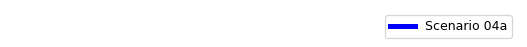

In [12]:
import matplotlib.lines as mlines
import matplotlib.pyplot as plt

plt.figure(figsize=(7.3, 0.01), dpi=90)
legend_elements = [mlines.Line2D([0], [0], color='blue', lw=4, label='Scenario 04a')]

plt.gca().set_axis_off()
plt.legend(handles=legend_elements, ncol=2);

## <span style='color:midnightblue'> Plot 7 - scatter plot with categorical x-axis, interactive legend and tooltip (climate change) </span>

<div class="alert alert-block alert-success">
The plot below is a simple scatter plot grouped by category (x-axis) with colour and shape representing categorical variables in the dataframe.
</div>

In [13]:
chart_data_p7 = pd.read_csv(".\\Plot7\\BarronWP_HydroEFO_annual_CC.csv")

In [14]:
## Interactive legend scatter plot for flow requirement

selection_col = alt.selection_multi(fields=['RCP'], bind='legend')

domain_rcp = ['Historical', 'RCP 4.5', 'RCP 8.5']
range_rcp = ['black', 'green', 'red']

base = alt.Chart(chart_data_p7).transform_fold( # Fold individual requirement columns into single 'location' column
    ['Hydropower','Mareeba EFO','Myola EFO'],
     as_=['location','mean']
).mark_point(
    stroke='black',
    strokeWidth=0.5,
    size=100,
    filled=True
).encode(
    alt.X('location:N', axis=alt.Axis(labelAngle=0),title='Flow requirement node'),
    alt.Y('mean:Q',title='Mean annual total flow requirement (ML/a)'),
    opacity=alt.condition(selection_col, alt.value(1), alt.value(0.2))
).properties(
    width=600,
    height=500,
    title={
    "text": ["Figure 1: Simulated Barron Water Plan base case (00i) - TFD flow requirement"]}
)

chart = base.encode(   
    alt.Color('RCP:N', scale=alt.Scale(domain=domain_rcp,range=range_rcp)),   # Color series based on RCP
    alt.Shape('GCM:N', sort=None),      
    opacity=alt.condition(selection_col, alt.value(1), alt.value(0.2))
).interactive(
).add_selection(
    selection_col
)

overlay = base.encode(
  opacity=alt.value(0),
  tooltip=['GCM:N',alt.Tooltip('mean:Q', format=",.0f", title="Mean requirement (ML/a)")], # Tooltip only reads selected series
).transform_filter(
    selection_col
)

chart + overlay

alt.LayerChart(...)

## <span style='color:midnightblue'> Plot 8 - Heatmap plot to represent 'failures' (or passes) by WY </span>

<div class="alert alert-block alert-success">
The plot below is a heatmap grouped by criteria (y-axis) to represent years in which a criteria is met, in this case at least one day at or below a storage volume in Storm King Dam.
</div>

In [24]:
chart_data_p8 = pd.read_csv(".\\Plot8\\GB_Hist_2050_01b_StormKingDam.in_AnnualDaysBelow_DF.csv",index_col=0)

In [30]:
# df column names must be str for Altair
chart_data_p8.columns=[str(x) for x in chart_data_p8.columns]

# Lookup table to convert count of events by WY to 'pass' or 'fail
lookup = pd.DataFrame({
    'key': ['1', '0'],
    'y': ['Fail','Pass']
})

domain = ['Pass', 'Fail']
range = ['white', 'red']
    
chart_wy_event = alt.Chart(chart_data_p8.reset_index() # Reset index so that Altair can access Date index
).transform_fold( # Fold individual columns into single column
    chart_data_p8.columns.values,
    as_=['column','value']
).transform_calculate( # Convert count of WY events to 1 or 0 based on criteria
    value='if(datum.value>=1,1,0)'
).transform_lookup( # Convert 1 and 0 to pass and fail
    lookup='value',
    from_=alt.LookupData(lookup, key='key', fields=['y'])
).mark_rect(stroke='black', strokeWidth=0.2
).encode(
    alt.X('index:O', title='Water Year'),
    alt.Y('column:N',sort=None, title="Storage volume trigger (ML)"),
    color=alt.Color('y:N', scale=alt.Scale(domain=domain,range=range), title="Key")
).properties(
    width=1400,
    height=100
)

chart_wy_event

alt.Chart(...)